In [1]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as Dataset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import pickle
from torch.utils.data import Subset

manualSeed = 999
random.seed(manualSeed)
torch.manual_seed(manualSeed)

### Hyperparameters

In [5]:
device=torch.device('cuda' if torch.cuda.is_available() else 'cpu')
LEARNING_RATE = 5e-5
BATCH_SIZE = 64
IMAGE_SIZE = 64
IMAGE_CHANNELS = 3
Z_DIM = 100
EPOCHS = 50
DISC_FEATURES = 64
GEN_FEATURES = 64
CRITIC_ITERS = 5
WEIGHT_CLIP = 0.015

### Download Images for Training

In [6]:
transform = transforms.Compose([
    transforms.Resize(IMAGE_SIZE),
    transforms.CenterCrop(IMAGE_SIZE),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
])
trainset = Dataset.CIFAR10('./data', download=True, train=True, transform=transform)
test = Dataset.CIFAR10('./data', download=True, train=False, transform=transform)
trainset=trainset+test

trainloader = torch.utils.data.DataLoader(trainset, shuffle=False, batch_size=BATCH_SIZE)

Files already downloaded and verified
Files already downloaded and verified


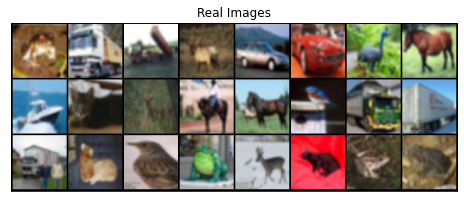

In [7]:
def imshow(imgs, title, figsize=(8,8), nrow=8):
    imgs = vutils.make_grid(imgs, nrow, normalize=True)
    imgs=imgs.numpy()
    plt.figure(figsize=figsize)
    plt.imshow(np.transpose(imgs, (1,2,0)))
    plt.xticks([])
    plt.yticks([])
    plt.title(title)
    plt.show()
    
images, labels = next(iter(trainloader))
imshow(images[:24], 'Real Images')

### Generator and Discriminator Models

In [8]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.net = nn.Sequential(
            #nn.ConvTranspose2d(Z_DIM, GEN_FEATURES*8, 4, 1, 0, bias=False)
            self._block(Z_DIM, GEN_FEATURES*8, 4, 1, 0),           # 512 x 4 x 4
            self._block(GEN_FEATURES*8, GEN_FEATURES*4, 4, 2, 1),  # 256 x 8 x 8
            self._block(GEN_FEATURES*4, GEN_FEATURES*2, 4, 2, 1),  # 128 x 16 x 16
            self._block(GEN_FEATURES*2, GEN_FEATURES, 4, 2, 1),      # 64 x 32 x 32
            nn.ConvTranspose2d(GEN_FEATURES, IMAGE_CHANNELS, 4, 2, 1),
            nn.Tanh() #size. (n_channels) x 64 x 64
        
        )
        
    def _block(self, in_channels, out_channels, kernel, stride, padding):
        return nn.Sequential(nn.ConvTranspose2d(in_channels, out_channels, kernel, stride, padding, bias=False),
                             nn.BatchNorm2d(out_channels),
                             nn.ReLU(True)
                            )
    
    def forward(self, z):
        return self.net(z)
    

In [9]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.net = nn.Sequential(
            # input size: 3 x 64 x 64
            nn.Conv2d(IMAGE_CHANNELS, DISC_FEATURES, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),                          # 64 x 32 x 32
            self._block(DISC_FEATURES, DISC_FEATURES*2, 4, 2, 1),     # 128 x 16 x 16
            self._block(DISC_FEATURES*2, DISC_FEATURES*4, 4, 2, 1),   # 256 x 8 x 8
            self._block(DISC_FEATURES*4, DISC_FEATURES*8, 4, 2, 1),   # 512 x 4 x 4
            nn.Conv2d(DISC_FEATURES*8, 1, 4, 1, 0, bias=False),       # 1 x 1 x 1
        )
        
        
    def _block(self, in_channels, out_channels, kernel, stride, padding):
        return nn.Sequential(nn.Conv2d(in_channels, out_channels, kernel, stride, padding, bias=False),
                             nn.BatchNorm2d(out_channels),
                             nn.LeakyReLU(0.2, inplace=True),
                            )
    
    def forward(self, x):
        return self.net(x)
    
    


In [10]:
def weight_initialization(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
        nn.init.constant_(m.bias.data, 0)
            
            
CriticModel = Discriminator().to(device)
GenModel = Generator().to(device)

#initialize weights for both models
CriticModel.apply(weight_initialization)
GenModel.apply(weight_initialization)


#latent vector to visualize the performance of the generator
fixed_noise = torch.randn(32, Z_DIM, 1, 1).to(device)

critic_optimizer = optim.RMSprop(CriticModel.parameters(), lr=LEARNING_RATE)
gen_optimizer = optim.RMSprop(GenModel.parameters(), lr=LEARNING_RATE)

# critic_optimizer = optim.Adam(CriticModel.parameters(), lr=LEARNING_RATE, betas=(0.0, 0.9))
# gen_optimizer = optim.Adam(GenModel.parameters(), lr=LEARNING_RATE, betas=(0.0, 0.9))


### Training

[10/50]   Loss_D:-3.406543731689453   Loss_G:1.585898756980896


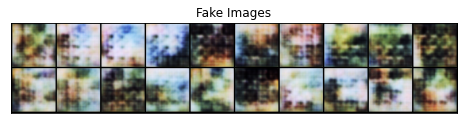

[20/50]   Loss_D:-3.4805681705474854   Loss_G:1.6307185888290405


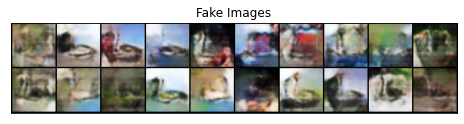

[30/50]   Loss_D:-3.4873557090759277   Loss_G:1.6358134746551514


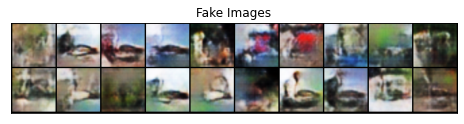

[40/50]   Loss_D:-3.3938002586364746   Loss_G:1.5812427997589111


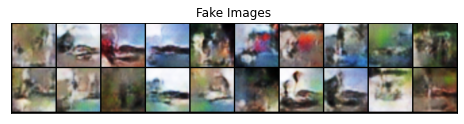

[50/50]   Loss_D:-3.444066047668457   Loss_G:1.6114966869354248


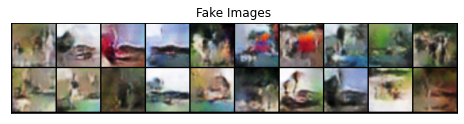

In [11]:
img_list = []
GEN_LOSS = []
CRITIC_LOSS = []
FID_score = []

for epoch in range(1,EPOCHS+1):
    GenModel.train()
    CriticModel.train()
    for i, (real, _) in enumerate(trainloader):
        real = real.to(device)
        
        
        #### (1) TRAIN CRITIC (DISCRIMINATOR) TO MAXIMIZE LOSS
        for _ in range(CRITIC_ITERS):
            mb_size = real.size(0)
            
            CriticModel.zero_grad()    
            noise = torch.randn(mb_size, Z_DIM, 1, 1).to(device)
            #generate fake images
            fake = GenModel(noise)
            #train critic with real images
            critic_real = CriticModel(real).view(-1)
            #train discriminator with fake images
            critic_fake = CriticModel(fake).view(-1)
            # Calculate loss on both real real and fake
            critic_loss = -(torch.mean(critic_real) - torch.mean(critic_fake))
            critic_loss.backward(retain_graph=True)
            critic_optimizer.step()
            
            #clip weight between -0.01 and 0.01
            for p in CriticModel.parameters():
                p.data.clamp_(-WEIGHT_CLIP, WEIGHT_CLIP)
        
        #### (2) TRAIN GENERATOR TO MINIMIZE LOSS
        GenModel.zero_grad()
        output = CriticModel(fake).view(-1)
        #calculate gen's loss
        lossGen = -torch.mean(output)
        lossGen.backward()
        #update generatir
        gen_optimizer.step()
        
        #if i%100 == 0:
        #save both losses for plot
        GEN_LOSS.append(lossGen.item())
        CRITIC_LOSS.append(critic_loss.item())
        
    with torch.no_grad():
        GenModel.eval()
        fakes = GenModel(fixed_noise).detach().cpu()
    img_list.append(vutils.make_grid(fakes, padding=2, normalize=True, nrow=6))
    vutils.save_image(fakes[:10].cpu(),'Images/wganimage10.png', nrow=10)
    
    vutils.save_image(real.cpu(),'Images/wganimages/real/image{}.png'.format(epoch), nrow=10, normalize=True)
    vutils.save_image(fakes.cpu(),'Images/wganimages/fake/image{}.png'.format(epoch), nrow=10, normalize=True)
    
    #compute fid score
    #fid_score = compute_fidScore(real, fakes)
    #FID_score.append(fid_score)
    
    if epoch%10 == 0:
        print(f'[{epoch}/{EPOCHS}]   Loss_D:{critic_loss.item()}   Loss_G:{lossGen.item()}') #, FID_Score:{fid_score:.2f}')
        imshow(fakes[:20].cpu(), 'Fake Images', figsize=(8,8), nrow=10)

        
#save generated images
vutils.save_image(fakes[:10].cpu(),'Images/wganimage10.png', nrow=10)
vutils.save_image(fakes[:24].cpu(),'Images/wganimage.png')
vutils.save_image(fakes[:10].cpu(),'Images/wganimage10norm.png', nrow=10, normalize=True)
vutils.save_image(fakes[:24].cpu(),'Images/wganimagenorm.png', normalize=True)

#save entire model
torch.save(GenModel,'Models/wgan.pth')  

#save losses to file
losses = {'GenLoss': GEN_LOSS,
         'CriticLoss': CRITIC_LOSS}
with open('pickle/wgan_loss.txt', 'wb') as f:
    pickle.dump(losses,f)

#save the generated images for visualization
with open('pickle/wganImg.txt', 'wb') as f:
    pickle.dump(img_list,f)

### Plot Loss

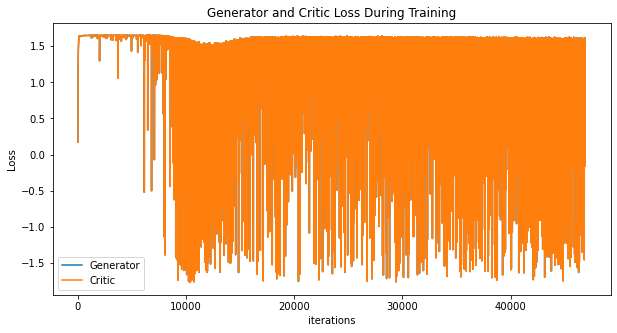

In [1]:
import pickle
import matplotlib.pyplot as plt
with open('pickle/wgan_loss.txt', 'rb') as f:
    loss = pickle.load(f)
    
plt.figure(figsize=(10,5))
plt.title("Generator and Critic Loss During Training")
plt.plot(loss['GenLoss'],label="Generator")
plt.plot(loss['GenLoss'],label="Critic")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

### Compute FID Scores

/home/maiyeti/.local/lib/python3.8/site-packages/scipy/linalg/_matfuncs_sqrtm.py:191: RuntimeWarning: invalid value encountered in double_scalars
  arg2 = norm(X.dot(X) - A, 'fro')**2 / norm(A, 'fro')


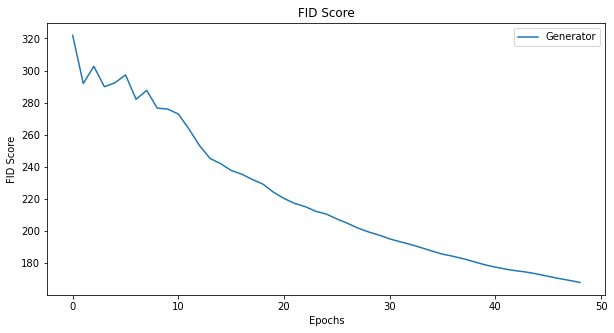

In [2]:
from FID import fidScore
wgan_FID = []
for i in range(1,50):
    i = i+1
    fids = fidScore('Images/wganimages/real', 'Images/wganimages/fake',i,64)
    print(f'Epoch:{i} and FID Score: {fids}', end = '\r', flush=True)
    wgan_FID.append(fids)
    

#save fid score list to file
with open('pickle/wganfid.txt', 'wb') as f:
    pickle.dump(wgan_FID,f)
    
plt.figure(figsize=(10,5))
plt.title("FID Score")
plt.plot(wgan_FID,label="Generator")
plt.xlabel("Epochs")
plt.ylabel("FID Score")
plt.legend()
plt.show()

### Visualize animation of images generated at every epoch

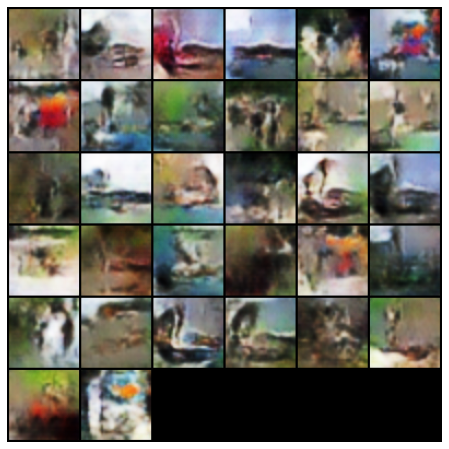

In [3]:
#%%capture
with open('pickle/wganImg.txt', 'rb') as f:
    image_list = pickle.load(f)

fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in image_list]
#ims=[[i, animated=True] for i in image_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [ ]:
type(img_list)